In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
%matplotlib inline

# Camera calibration

In [2]:
# Camera Calibration
images = glob.glob("camera_cal/calibration*.jpg")

objpoints = []
imgpoints = []

objp = np.zeros((6*9, 3), np.float32)
objp[:, :2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

for frame in images:
    img = mpimg.imread(frame)
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], \
                                                   None, None)

Show resluts after calibration

/Users/bai/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<Figure size 432x288 with 0 Axes>

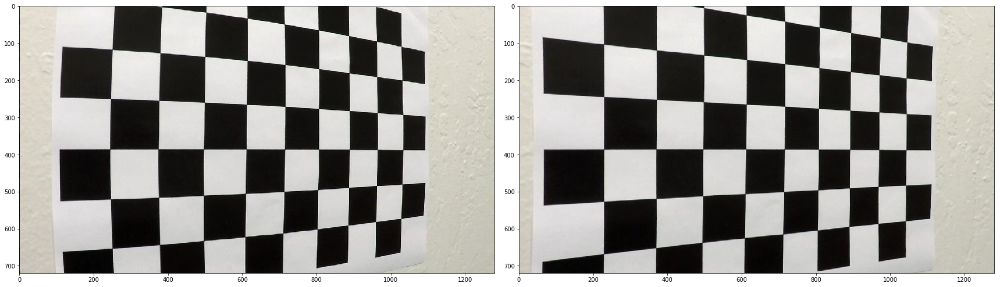

<Figure size 432x288 with 0 Axes>

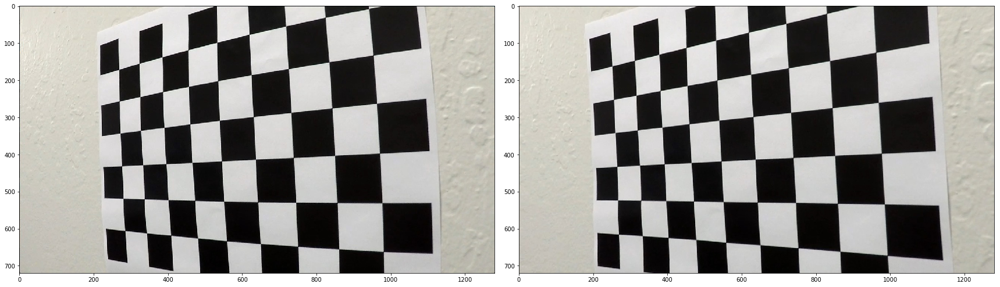

<Figure size 432x288 with 0 Axes>

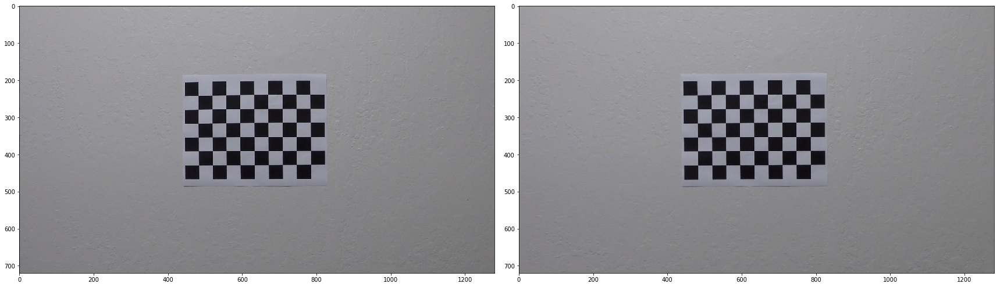

<Figure size 432x288 with 0 Axes>

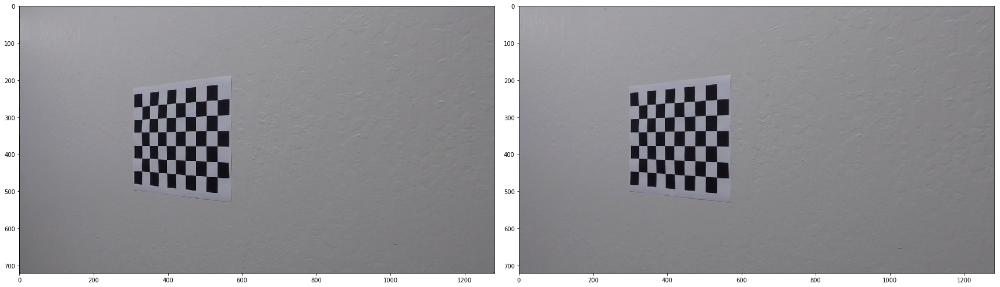

<Figure size 432x288 with 0 Axes>

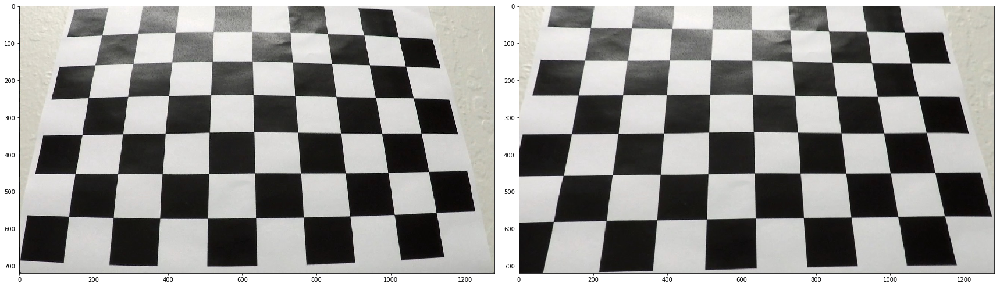

<Figure size 432x288 with 0 Axes>

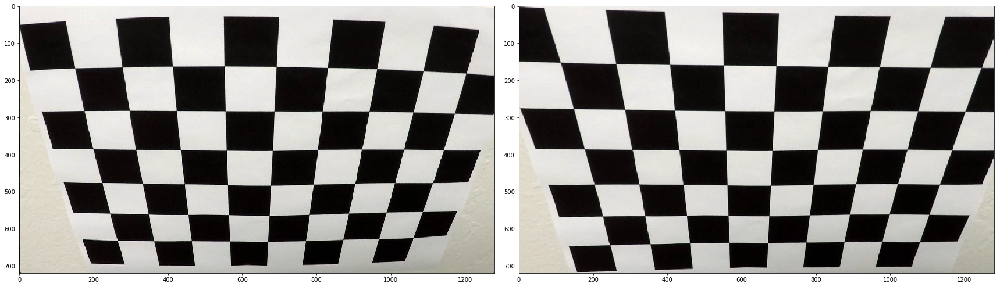

<Figure size 432x288 with 0 Axes>

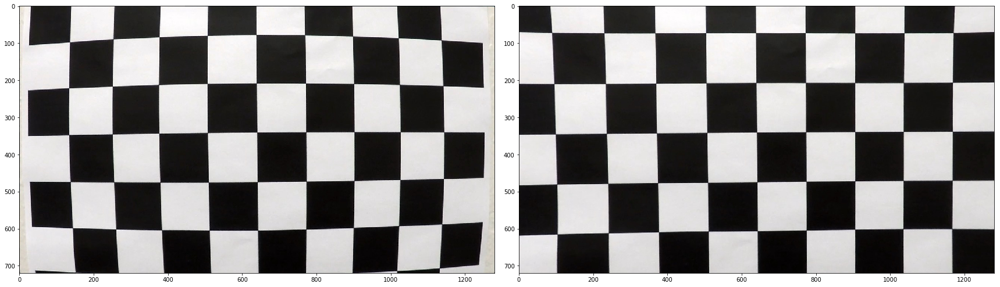

<Figure size 432x288 with 0 Axes>

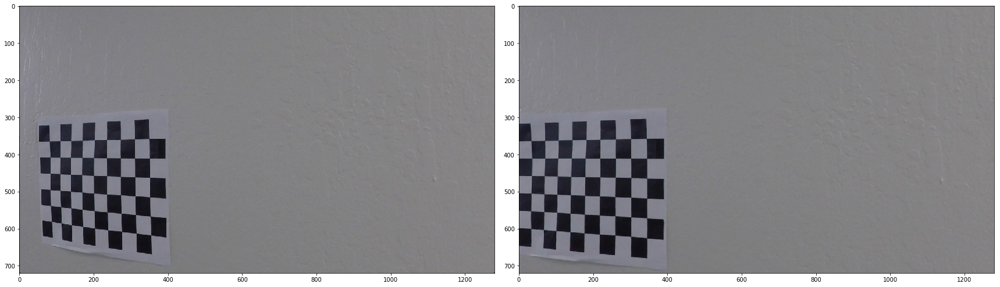

<Figure size 432x288 with 0 Axes>

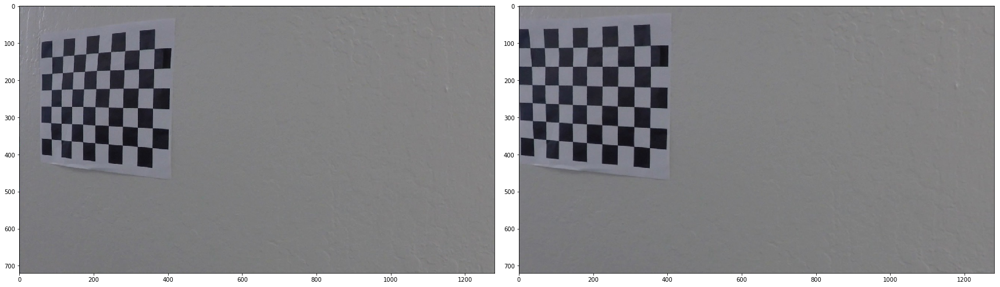

<Figure size 432x288 with 0 Axes>

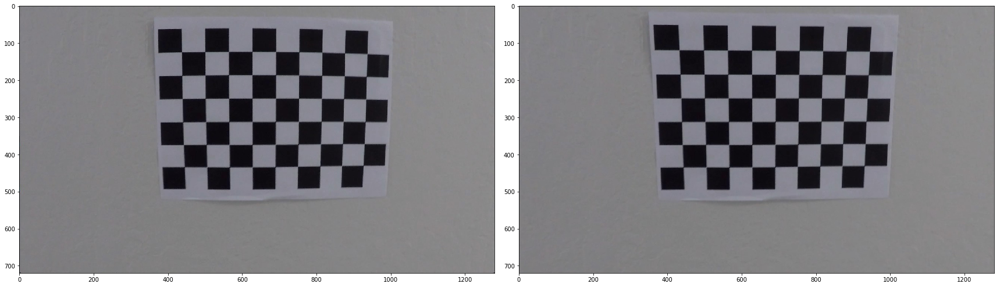

<Figure size 432x288 with 0 Axes>

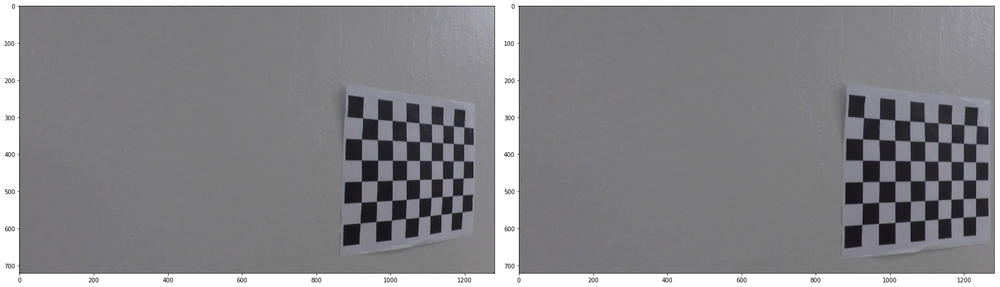

<Figure size 432x288 with 0 Axes>

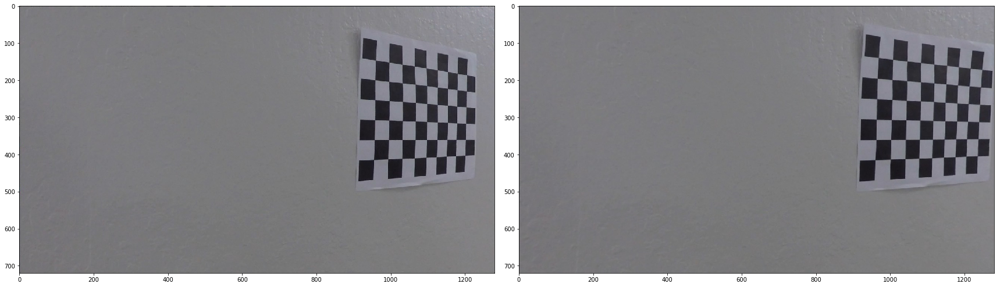

<Figure size 432x288 with 0 Axes>

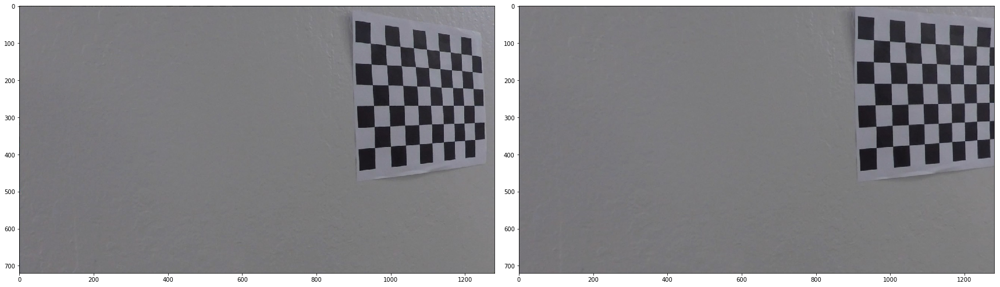

<Figure size 432x288 with 0 Axes>

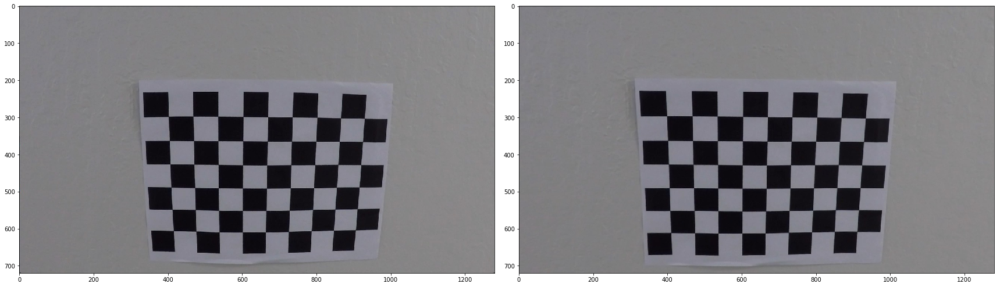

<Figure size 432x288 with 0 Axes>

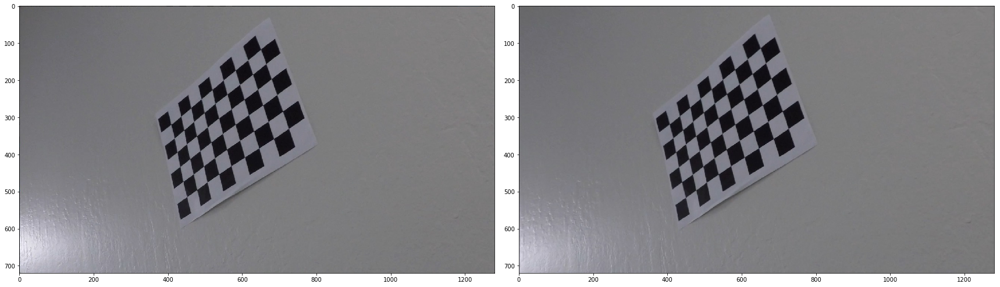

<Figure size 432x288 with 0 Axes>

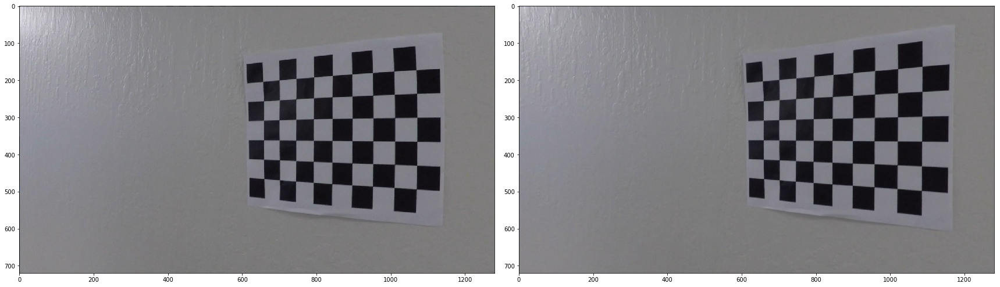

<Figure size 432x288 with 0 Axes>

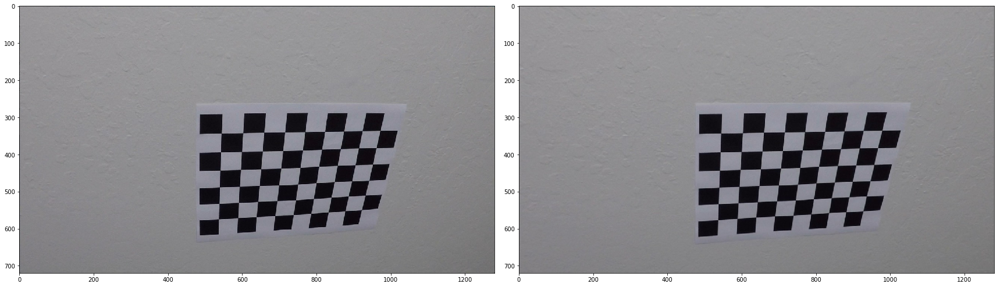

<Figure size 432x288 with 0 Axes>

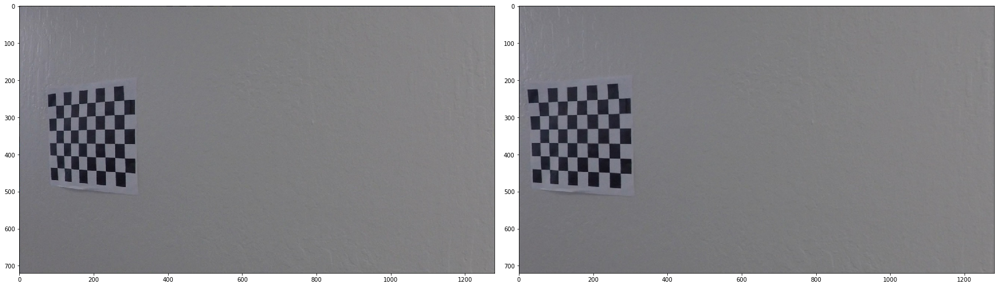

<Figure size 432x288 with 0 Axes>

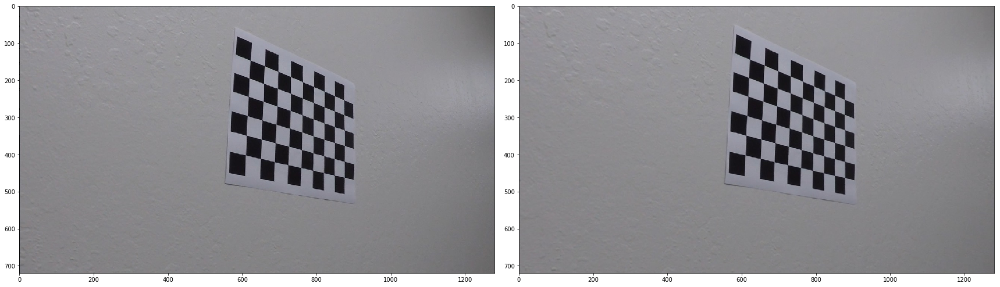

<Figure size 432x288 with 0 Axes>

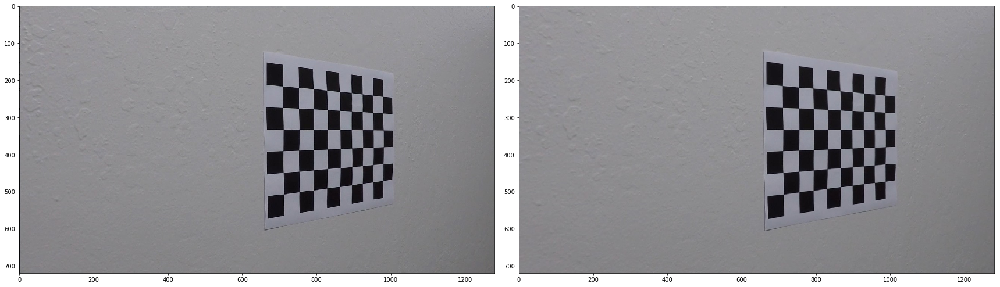

In [3]:
for i, frame in enumerate(images):
    plt.figure()
    img = mpimg.imread(frame)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax2.imshow(dst)
    plt.imsave("output_images/camera_cal/"+str(i)+".png", dst)

# Detect Lane lines

In [4]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh_min=0, thresh_max=255):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh_min) & (scaled_sobel < thresh_max)] = 1
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    abs_sobelxy = np.sqrt(sobelx ** 2 + sobely ** 2)
    scaled_sobel = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > mag_thresh[0]) & (scaled_sobel < mag_thresh[1])] = 1
    return binary_output

def dir_thresh(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_sobelx = np.abs(sobelx)
    abs_sobely = np.abs(sobely)
    direction = np.arctan2(abs_sobely, abs_sobelx)
    binary_output = np.zeros_like(direction)
    binary_output[(direction > thresh[0]) & (direction < thresh[1])] = 1
    return binary_output

def color_thresh(img, s_thresh=(180, 255), r_thresh=(100,200)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    R = img[:, :, 0]
    binary_r = np.zeros_like(gray)
    binary_r[(R > r_thresh[0]) & (R < r_thresh[1])] = 1
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:, :, 2]
    binary_s = np.zeros_like(gray)
    binary_s[(S > s_thresh[0]) & (S < s_thresh[1])] = 1
    
    binary_output = np.zeros_like(gray)
    binary_output[(binary_r == 1) & (binary_s == 1)] = 1
    return binary_output

# Define a mask to only process certain region of interest
def region_of_interest(img, vertices):
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

# Combining all threshold together to detect lane line
def detect_lane_line(img, mtx, dist, vertices):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    output = np.zeros_like(gray)
    color = color_thresh(undist, (100, 255), (90, 255))
    gdx = abs_sobel_thresh(undist, orient='x', sobel_kernel=3, thresh_min=30, thresh_max=255)
    mag = mag_thresh(undist, sobel_kernel=3, mag_thresh=(50, 255))
    dirt = dir_thresh(undist, sobel_kernel=15, thresh=(0.7, 1.3))
    output[(color == 1) | (mag == 1) & (gdx == 1) & (dirt == 1)] = 1
    masked_img = region_of_interest(output, vertices)
    return masked_img

Test lane line detection on test images

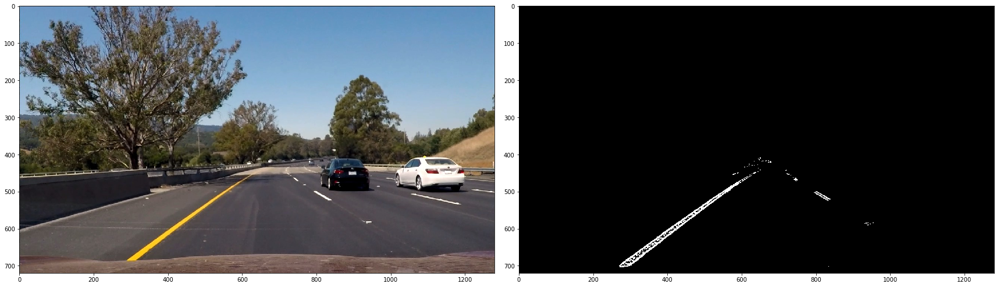

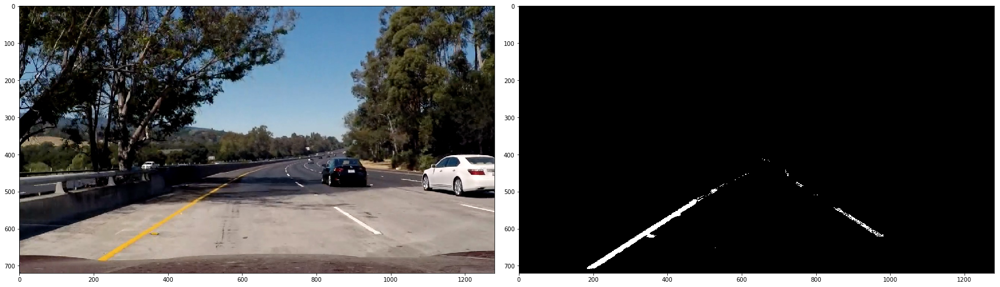

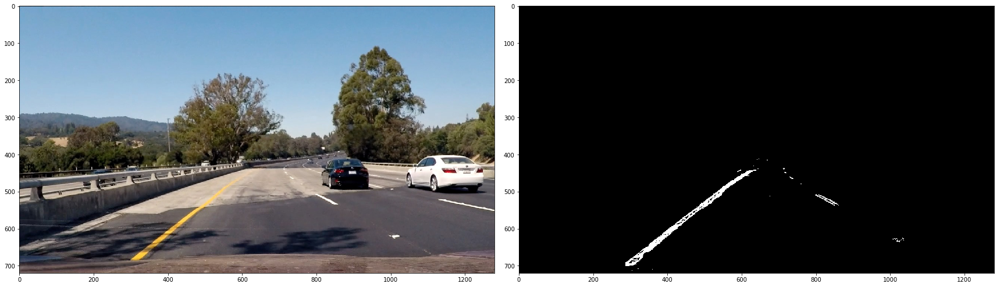

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


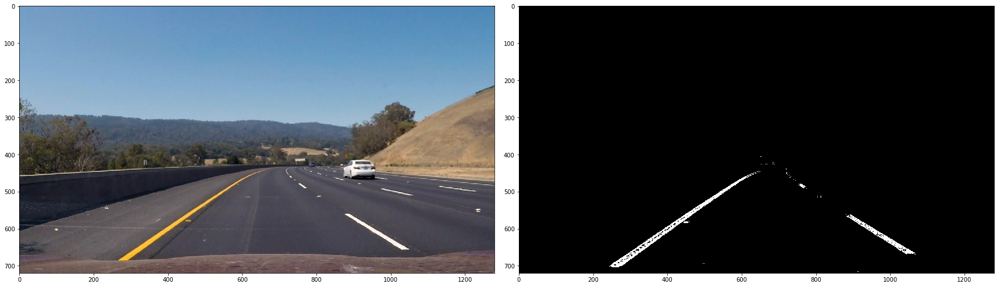

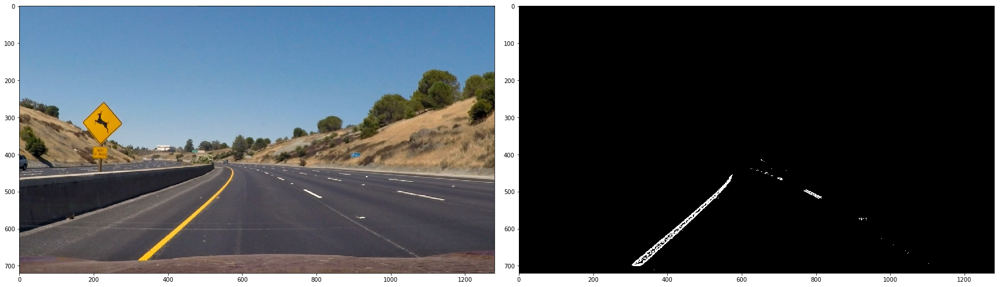

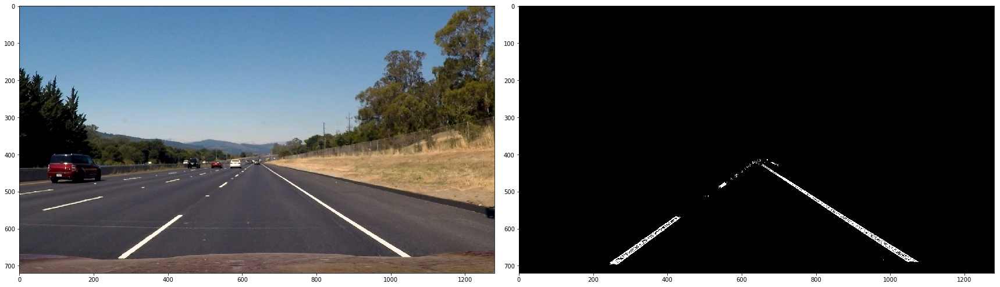

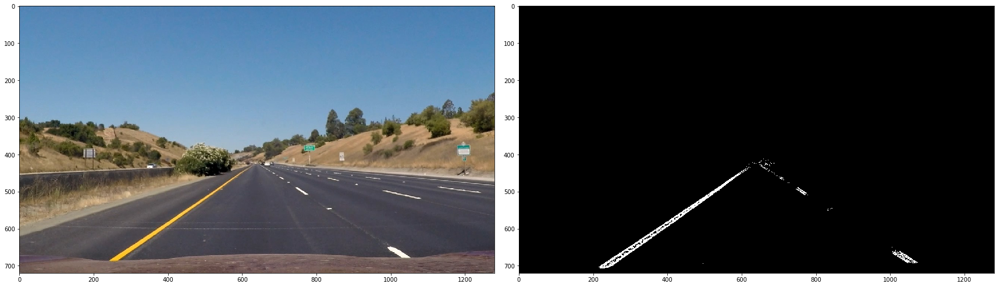

In [5]:
images = glob.glob("test_images/*.jpg")
image_list = []

binary_lane_images = []
for i, frame in enumerate(images):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    img = mpimg.imread(frame)
    image_list.append(img)
    ax1.imshow(img)
    
    vertices = np.array([[(img.shape[1]//8, img.shape[0]), (img.shape[1], img.shape[0]), \
               (img.shape[1]//2, img.shape[0]*5//9), (img.shape[1]//2+20, img.shape[0]*5//9)]])
    output = detect_lane_line(img, mtx, dist, vertices)
    binary_lane_images.append(output)
    ax2.imshow(output, cmap='gray')
    plt.imsave("output_images/lane_detect_before_transform/"+str(i)+".png", output)

# Perspective transform

In [6]:
src = np.float32([[272, 673],
      [1035, 673],
      [602, 447],
      [682, 447]])
    
dst = np.float32([[250, 720],
      [1000, 720],
      [250, 0],
      [1000,0]])

M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)
    
def perspective_transform(img): 
    img_size = (img.shape[1], img.shape[0])
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped

Test perspective transform on test images

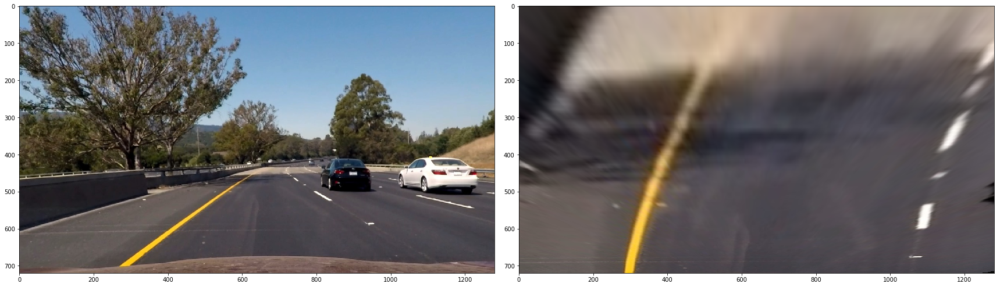

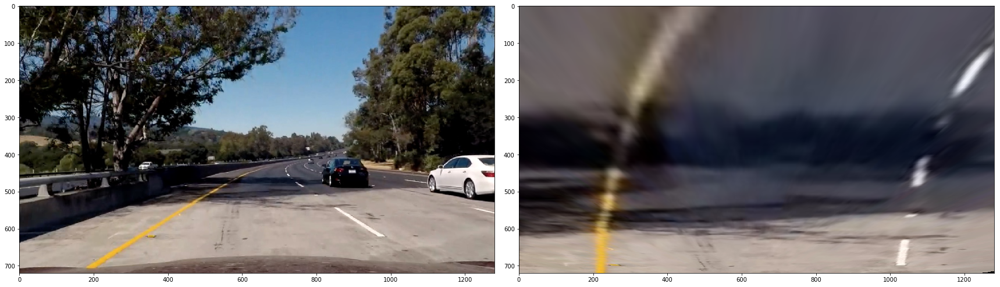

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


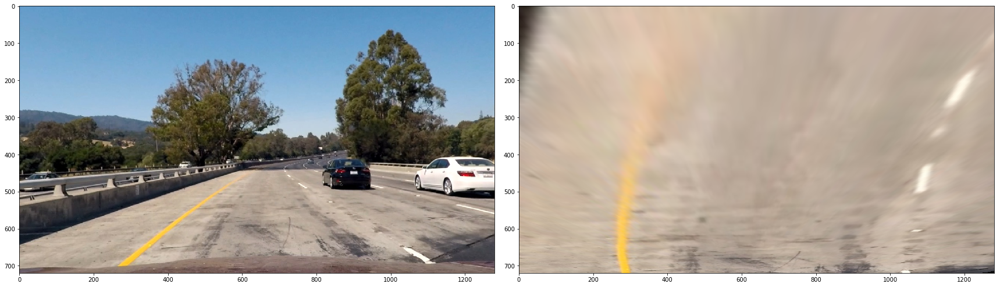

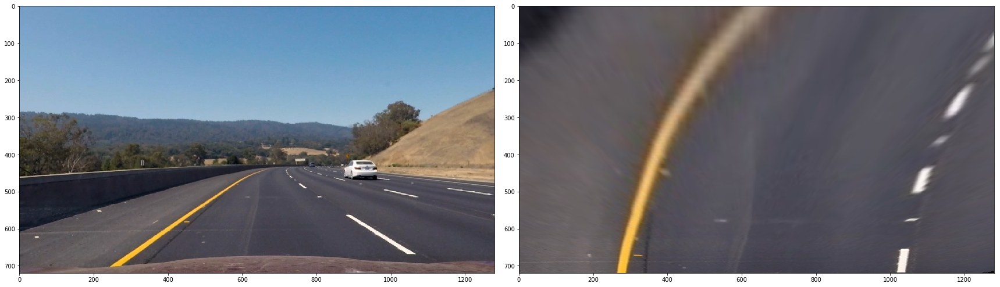

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


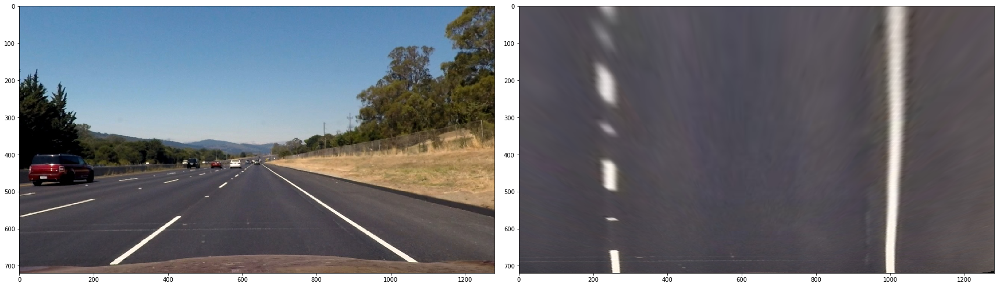

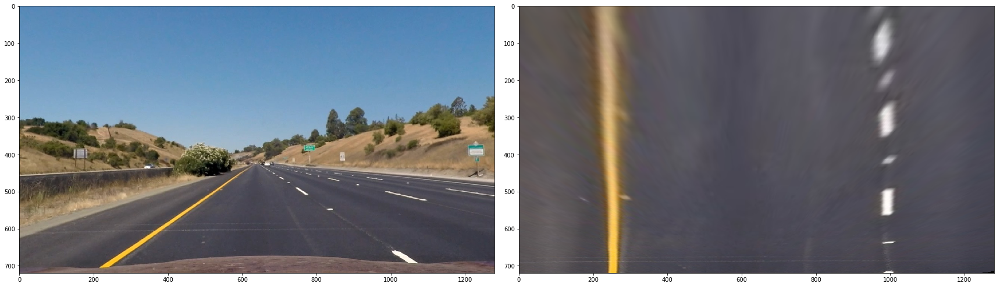

In [7]:
images = glob.glob("test_images/*.jpg")

for i, frame in enumerate(images):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    img = mpimg.imread(frame)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    ax1.imshow(undist)
    
    output = perspective_transform(undist)
    ax2.imshow(output)
    plt.imsave("output_images/perspective/"+str(i)+".jpg", output)

Test perspective transform on lane line detection binary images

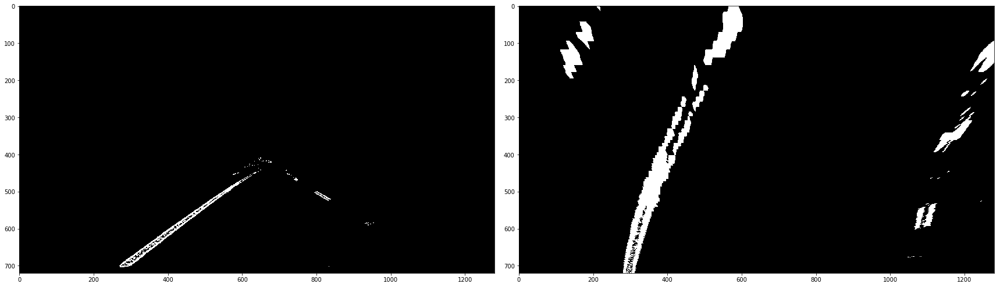

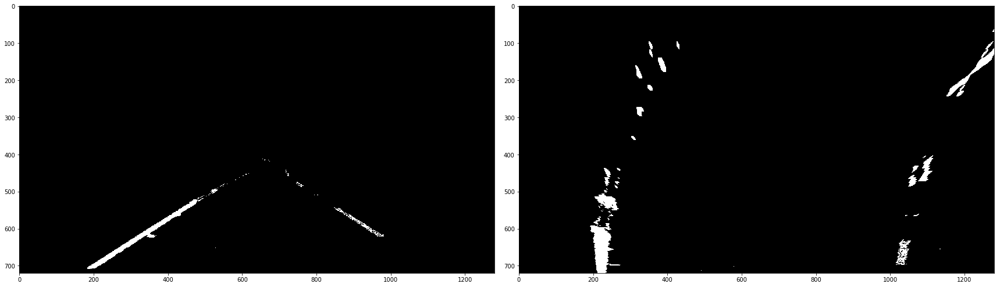

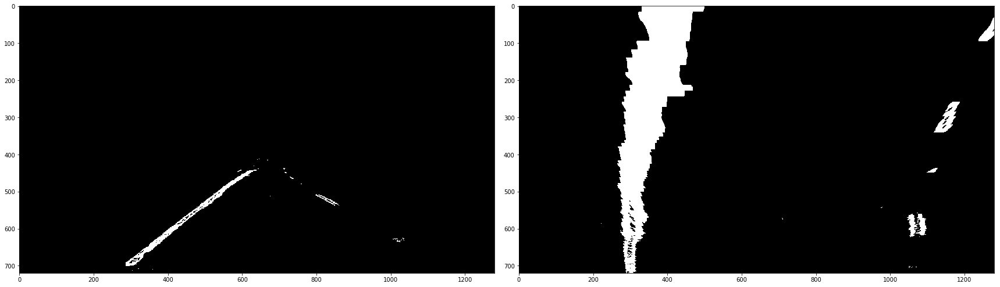

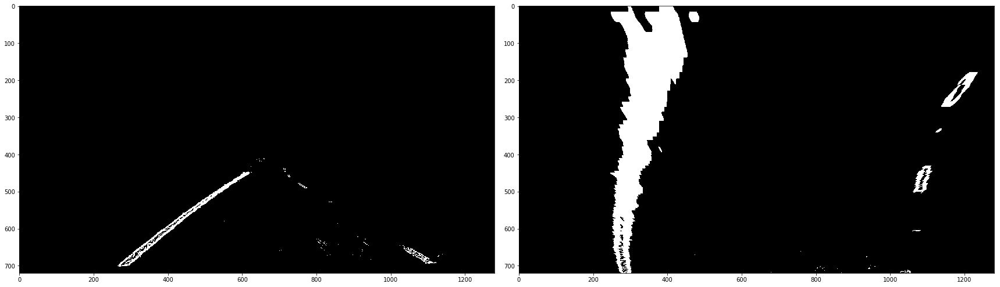

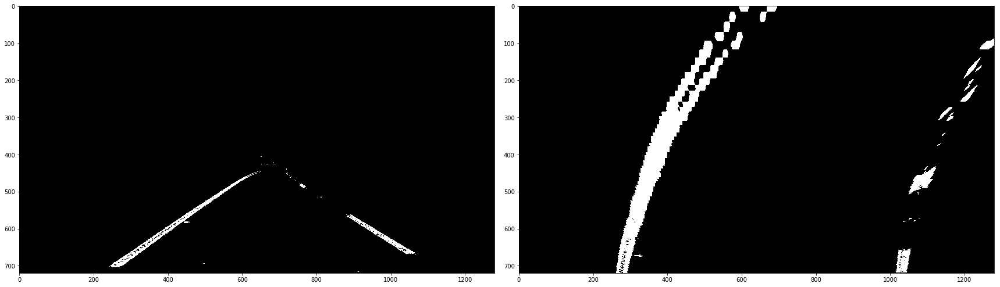

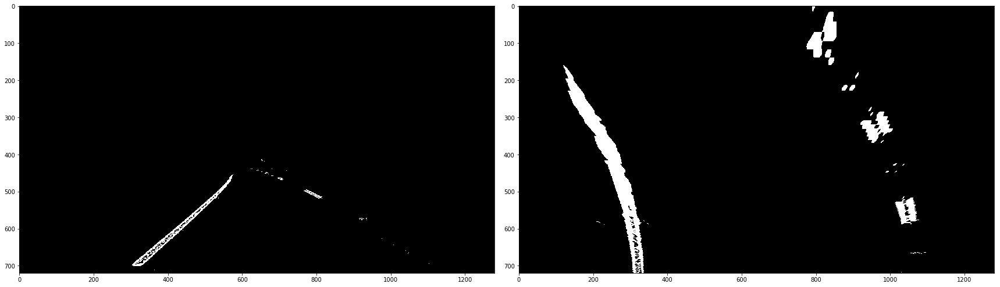

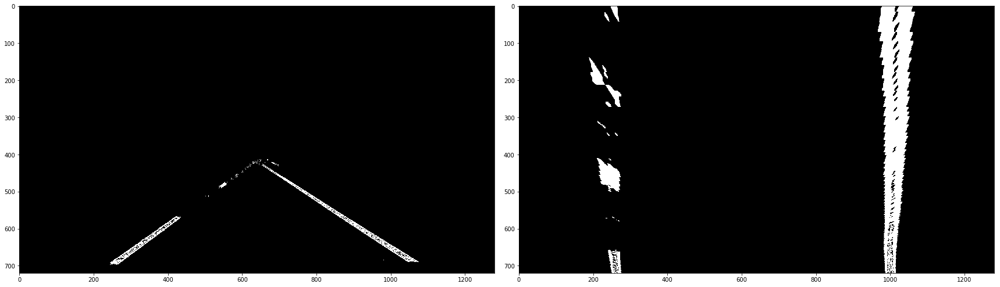

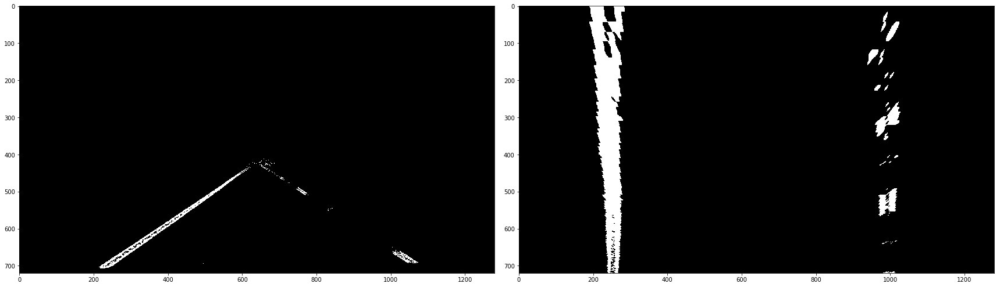

In [8]:
transformed_binary = []
for i, frame in enumerate(binary_lane_images):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(frame, cmap='gray')
    
    output = perspective_transform(frame)
    ax2.imshow(output, cmap='gray')
    transformed_binary.append(output)
    plt.imsave("output_images/lane_detect_after_transform/"+str(i)+".png", output)

# Detect curvature

In [9]:
# Some helper function
# Hyperparameter
CRI_RATIO = 3.0
CRI_LARGE = 1000
H_MIN, H_MAX = 600, 1000

def measure_curvature(xm_per_pix, ym_per_pix, leftx, lefty, rightx, righty, shape):
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    y_eval = shape - 1
    left_curverad = (1+(2*left_fit_cr[0]*y_eval*ym_per_pix+left_fit_cr[1])**2)**1.5/np.abs(2*left_fit_cr[0])  
    right_curverad = (1+(2*right_fit_cr[0]*y_eval*ym_per_pix+right_fit_cr[1])**2)**1.5/np.abs(2*right_fit_cr[0])  
    return left_curverad, right_curverad

def sanity_check(left_fit, right_fit, left_curve, right_curve, shape):
    # 1. similar curvature
    if left_curve/right_curve < 1.0/CRI_RATIO or left_curve/right_curve > CRI_RATIO:
        l_curvature = False
    else:
        l_curvature = True
        
    # 2. right horizontal distance & parallel
    l_parallel = True
    for y in range(shape - 1, -1, -1):
        left_base = left_fit[0]*y**2 + left_fit[1]*y + left_fit[2]
        right_base = right_fit[0]*y**2 + right_fit[1]*y + right_fit[2]
        if H_MIN < np.abs(left_base - right_base) < H_MAX:
            pass
        else:
            l_parallel = False
            break
    
    return l_curvature or l_parallel

The following functions use sliding window to find lane pixels

In [10]:
def find_lane_pixels(binary_warped):
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 50
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Set minimun number of pixels to be considered found a lane
    minfound = 2000

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Identify the x and y positions of all nonzero (i.e. activated) pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current - margin  # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = [i for i in range(len(nonzerox)) \
                          if (win_xleft_low <= nonzerox[i] < win_xleft_high) and \
                          (win_y_low <= nonzeroy[i] < win_y_high)]
        good_right_inds = [i for i in range(len(nonzerox)) \
                           if (win_xright_low <= nonzerox[i] < win_xright_high) and \
                           (win_y_low <= nonzeroy[i] < win_y_high)]
        
        # Append these indices to the lists
        left_lane_inds.extend(good_left_inds)
        right_lane_inds.extend(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
            leftx_current = int(sum([nonzerox[i] for i in good_left_inds]) / \
                                len(good_left_inds))
        if len(good_right_inds) > minpix:
            rightx_current = int(sum([nonzerox[i] for i in good_right_inds]) / \
                                 len(good_right_inds))
            
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds] 
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds] 
    righty = nonzeroy[right_lane_inds] 

    return leftx, lefty, rightx, righty, out_img

def search_from_window(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    
    if len(leftx) == 0 or len(rightx) == 0:
        return None, None, None, None, None, None, None, None, None, None, False

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
        
    # Calculate curvature
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/750 # meters per pixel in x dimension
    left_curverad, right_curverad = measure_curvature(xm_per_pix, ym_per_pix, leftx, lefty, \
                                                      rightx, righty, binary_warped.shape[1])
    
    # Calculate offset
    camera_center = (left_fitx[-1] + right_fitx[-1]) / 2
    offset = (camera_center - binary_warped.shape[1] / 2) * xm_per_pix
    side = 'left'
    if offset <= 0:
        offset = -offset
        side = 'right' 
    
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img, left_fit, right_fit, left_curverad, right_curverad, \
           left_fitx, right_fitx, ploty, offset, side,\
        sanity_check(left_fit, right_fit, left_curverad, right_curverad, binary_warped.shape[1])

Test on sliding window detection on test images

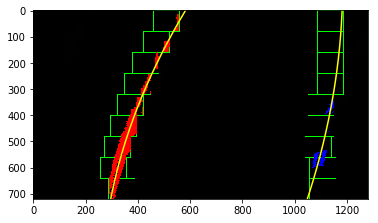

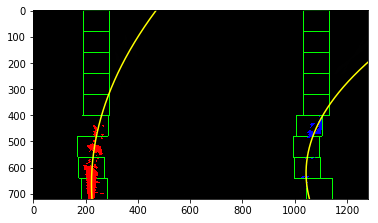

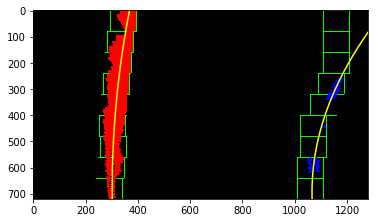

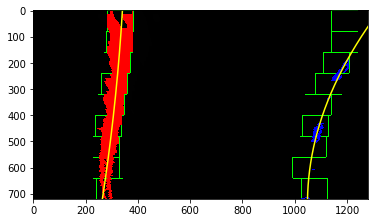

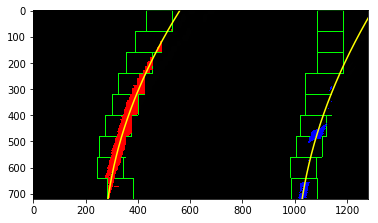

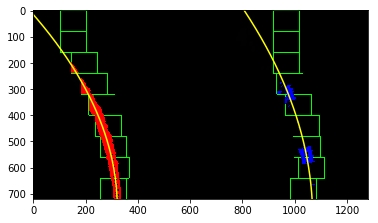

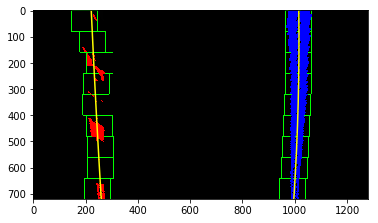

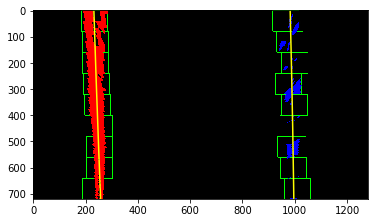

In [11]:
l_fit = []
r_fit = []

for i, frame in enumerate(transformed_binary):
    plt.figure()
    out_img, lt, rt, left_curve, right_curve, lx, rx, fity, offset, side, found = search_from_window(frame)
    l_fit.append(lt)
    r_fit.append(rt)
    plt.imshow(out_img)
    plt.imsave("output_images/sliding_window/"+str(i)+".png", out_img)

The following functions use previous poly fit to detect lane lines

In [12]:
# Search from prior

def fit_poly(img_shape, leftx, lefty, rightx, righty):
    ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty, left_fit, right_fit

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 50

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    fit_lx = left_fit[0]*nonzeroy**2 + left_fit[1]*nonzeroy + left_fit[2]
    left_lane_inds = [i for i in range(len(nonzerox)) if fit_lx[i] - margin < nonzerox[i] < fit_lx[i] + margin]
    fit_rx = right_fit[0]*nonzeroy**2 + right_fit[1]*nonzeroy + right_fit[2]
    right_lane_inds = [i for i in range(len(nonzeroy)) if fit_rx[i] - margin < nonzerox[i] < fit_rx[i] + margin]
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    if len(leftx) == 0 or len(rightx) == 0:
        return None, None, None, None, None, None, None, None, None, None, False
    
    # Fit new polynomials
    left_fitx, right_fitx, ploty, left_fit, right_fit = fit_poly(binary_warped.shape, leftx, \
                                                                 lefty, rightx, righty)
    
    # Calculate curvature
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/750 # meters per pixel in x dimension
    left_curverad, right_curverad = measure_curvature(xm_per_pix, ym_per_pix, leftx, lefty, \
                                                      rightx, righty, binary_warped.shape[1])
    
    # Calculate offset
    camera_center = (left_fitx[-1] + right_fitx[-1]) / 2
    offset = (camera_center - binary_warped.shape[1] / 2) * xm_per_pix
    side = 'left'
    if offset <= 0:
        offset = -offset
        side = 'right' 
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result, left_fit, right_fit, left_curverad, right_curverad,\
           left_fitx, right_fitx, ploty, offset, side,\
        sanity_check(left_fit, right_fit, left_curverad, right_curverad, binary_warped.shape[1])

# Drawing lane line area and text on original image

In [13]:
def drawing(image, warped, left_fitx, right_fitx, ploty, mtx, dist, Minv, left_cur, offset, side):

    undist = cv2.undistort(image, mtx, dist, None, mtx)
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    # Area between two lanes
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    # Area for two lanes
    width = 50
    left_l = np.array([np.transpose(np.vstack([left_fitx-width//2, ploty]))])
    left_r = np.array([np.flipud(np.transpose(np.vstack([left_fitx+width//2, ploty])))])
    left_line = np.hstack((left_l, left_r))
    right_l = np.array([np.transpose(np.vstack([right_fitx-width//2, ploty]))])
    right_r = np.array([np.flipud(np.transpose(np.vstack([right_fitx+width//2, ploty])))])
    right_line = np.hstack((right_l, right_r))

    # Draw lanes red
    cv2.fillPoly(color_warp, np.int_([left_line]), (255,0, 0))
    cv2.fillPoly(color_warp, np.int_([right_line]), (255,0, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    # Put text on images
    cv2.putText(result, 'Author : Bai Xue', (50, 50), cv2.FONT_HERSHEY_PLAIN, 2.5,
                (255, 255, 255), 2)
    cv2.putText(result, 'Radius of Curvature = ' + str(int(left_cur)) + ' m',
                (50, 100), cv2.FONT_HERSHEY_PLAIN, 2.5,
                (255, 255, 255), 2)
    cv2.putText(result, 'Vehicle is ' + str(abs(round(offset, 3))) + ' m ' + side + ' of center', (50, 150), cv2.FONT_HERSHEY_PLAIN,
                2.5, (255, 255, 255), 2)
    
    return result

Test poly fit and drawing on test images

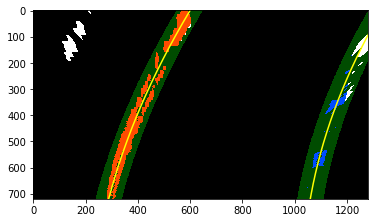

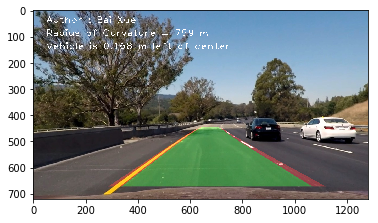

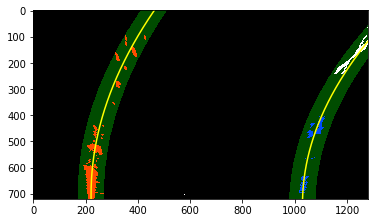

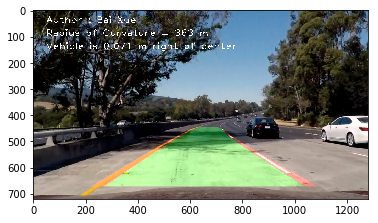

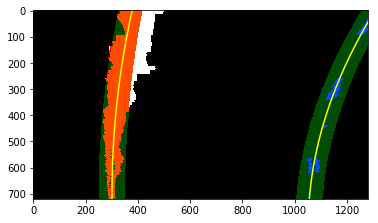

...

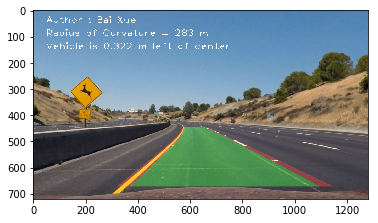

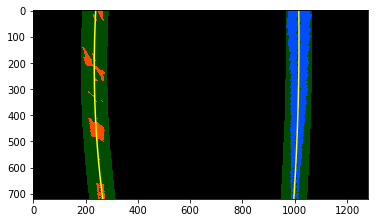

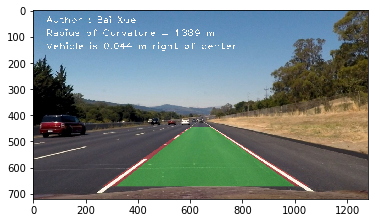

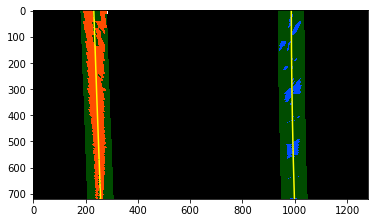

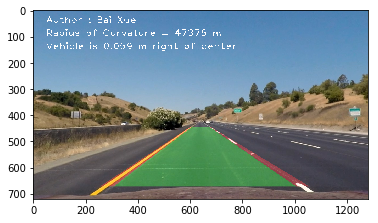

In [14]:
for i, frame in enumerate(transformed_binary):
    plt.figure()
        
    output, l_f, r_f, left, right, lx, rx, fity, offset, side, found = search_around_poly(frame, l_fit[i], r_fit[i])
    plt.imshow(output)
    
    plt.figure()
    result = drawing(image_list[i], frame, lx, rx, fity, mtx, dist, Minv, left, offset, side)
    plt.imshow(result)
    plt.imsave("output_images/poly_fit/"+str(i)+".png", output)
    plt.imsave("output_images/plot_back/"+str(i)+".png", result)

# Pipeline

In [15]:
from collections import deque

In [16]:
# Hyperparameters
N = 15

class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # How many frames consecutively lose lane
        self.lose = 0
        # x values of the last n fits of the line
        self.recent_xfitted = deque(maxlen=N) 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = deque(maxlen=N)  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        # side of center
        self.side = None
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  

In [17]:
left_lane = Line()
right_lane = Line()

In [18]:
def process(img):
    # 1. Find lane lines    
    vertices = np.array([[(img.shape[1]//8, img.shape[0]), (img.shape[1], img.shape[0]), \
               (img.shape[1]//2, img.shape[0]*5//9), (img.shape[1]//2+20, img.shape[0]*5//9)]])
    binary = detect_lane_line(img, mtx, dist, vertices)
    
    # 2. Perspective transform
    binary_warped = perspective_transform(binary)
    
    # 3. Calculate curvature
    if left_lane.best_fit is None or left_lane.lose > N:
        output, left_fit, right_fit, left_curverad, right_curverad, lx, rx, y, offset, side, found = \
        search_from_window(binary_warped)
        if found:
            left_lane.detected = True
            left_lane.lose = 0
            
            left_lane.recent_xfitted.clear()
            right_lane.recent_xfitted.clear()
            left_lane.recent_xfitted.append(lx[-1])
            right_lane.recent_xfitted.append(rx[-1])
            
            left_lane.bestx = lx[-1]
            right_lane.bestx = rx[-1]
            
            left_lane.current_fit.clear()
            right_lane.current_fit.clear()
            left_lane.current_fit.append(left_fit)
            right_lane.current_fit.append(right_fit)
            
            left_lane.best_fit = left_fit
            right_lane.best_fit = right_fit
            
            left_lane.radius_of_curvature = left_curverad
            right_lane.radius_of_curvature = right_curverad
            
            left_lane.line_base_pos = offset
            left_lane.side = side
            
            left_lane.allx = lx
            left_lane.ally = y
            right_lane.allx = rx
            right_lane.ally = y
            
        else:
            left_lane.lose += 1
    else:
        output, left_fit, right_fit, left_curverad, right_curverad, lx, rx, y, offset, side, found = \
        search_around_poly(binary_warped, left_lane.best_fit, right_lane.best_fit)
        if found:
            left_lane.detected = True
            left_lane.lose = 0
            
            left_lane.recent_xfitted.append(lx[-1])
            right_lane.recent_xfitted.append(rx[-1])
            
            length = len(left_lane.recent_xfitted)
            left_lane.bestx = sum(left_lane.recent_xfitted) / length
            right_lane.bestx = sum(right_lane.recent_xfitted) / length
            
            left_lane.current_fit.append(left_fit)
            right_lane.current_fit.append(right_fit)
            
            left_lane.best_fit = np.array([sum([left_lane.current_fit[i][j] for i in range(length)])/length\
                                     for j in range(3)])
            right_lane.best_fit = np.array([sum([right_lane.current_fit[i][j] for i in range(length)])/length\
                                     for j in range(3)])
            
            left_lane.radius_of_curvature = left_curverad
            right_lane.radius_of_curvature = right_curverad
            
            left_lane.line_base_pos = offset
            left_lane.side = side 
            
            left_lane.allx = lx
            left_lane.ally = y
            right_lane.allx = rx
            right_lane.ally = y
        else:
            left_lane.lose += 1
            
    output = drawing(img, binary_warped, left_lane.allx, right_lane.allx, left_lane.ally, \
                     mtx, dist, Minv, left_lane.radius_of_curvature, \
                     left_lane.line_base_pos, left_lane.side)
    return output
    

# Project video process

In [19]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [12:46<00:00,  1.64it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 11min 42s, sys: 1min 42s, total: 13min 24s
Wall time: 12min 48s


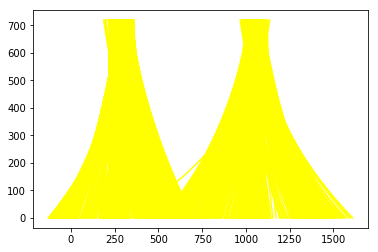

In [20]:
video_output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
video_clip = clip1.fl_image(process)
%time video_clip.write_videofile(video_output, audio=False)

In [21]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))